# Importing Libraries

In [1]:
import sys
sys.path.append('../')

In [2]:
%load_ext autoreload
%autoreload 2
import IPython.display
import matplotlib.pyplot as plt
import cv2
import numpy as np
import pickle as pkl
from utils import utils_ade20k
import pandas as pd 
import shutil

C:\Users\bhole\AppData\Local\Temp\ipykernel_34388\913968818.py:9: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


# Using ADE20K Dataset Pickle File

In [3]:
# Load index with global information about ADE20K
DATASET_PATH = 'D:/Dataset/snehalb06_739a88df/'
index_file = 'ADE20K_2021_17_01/index_ade20k.pkl'
with open('{}/{}'.format(DATASET_PATH, index_file), 'rb') as f:
    index_ade20k = pkl.load(f)

In [4]:
for k,v in index_ade20k.items():
    print(k," : ",len(v))

filename  :  27574
folder  :  27574
objectIsPart  :  3688
objectPresence  :  3688
objectcounts  :  3688
objectnames  :  3688
proportionClassIsPart  :  3688
scene  :  27574
wordnet_found  :  3688
wordnet_level1  :  3688
wordnet_synset  :  3680
wordnet_hypernym  :  3680
wordnet_gloss  :  3680
wordnet_frequency  :  3680
description  :  15


## Description of the fields 

In [5]:
index_ade20k['description']

{'filename': 'array of length N=27574 with the image file names',
 'folder': 'array of length N with the image folder names.',
 'scene': 'array of length N providing the scene name (same classes as the Places database) for each image.',
 'objectIsPart': 'array of size [C, N] counting how many times an object is a part in each image. objectIsPart[c,i]=m if in image i object class c is a part of another object m times. For objects, objectIsPart[c,i]=0, and for parts we will find: objectIsPart[c,i] = objectPresence(c,i)',
 'objectPresence': 'array of size [C, N] with the object counts per image. objectPresence(c,i)=n if in image i there are n instances of object class c.',
 'objectcounts': 'array of length C with the number of instances for each object class.',
 'objectnames': 'array of length C with the object class names.',
 'proportionClassIsPart': 'array of length C with the proportion of times that class c behaves as a part. If proportionClassIsPart[c]=0 then it means that this is a 

In [6]:
index_ade20k.keys()


dict_keys(['filename', 'folder', 'objectIsPart', 'objectPresence', 'objectcounts', 'objectnames', 'proportionClassIsPart', 'scene', 'wordnet_found', 'wordnet_level1', 'wordnet_synset', 'wordnet_hypernym', 'wordnet_gloss', 'wordnet_frequency', 'description'])

## Demo with Image

In [7]:
print("File loaded, description of the attributes:")
print('--------------------------------------------')
for attribute_name, desc in index_ade20k['description'].items():
    print('* {}: {}'.format(attribute_name, desc))
print('--------------------------------------------\n')

i = 16899 # 16899, 16964
nfiles = len(index_ade20k['filename'])
file_name = index_ade20k['filename'][i]
num_obj = index_ade20k['objectPresence'][:, i].sum()
num_parts = index_ade20k['objectIsPart'][:, i].sum()
count_obj = index_ade20k['objectPresence'][:, i].max()
obj_id = np.where(index_ade20k['objectPresence'][:, i] == count_obj)[0][0]
obj_name = index_ade20k['objectnames'][obj_id]
full_file_name = '{}/{}'.format(index_ade20k['folder'][i], index_ade20k['filename'][i])

print("The dataset has {} images".format(nfiles))
print("The image at index {} is {}".format(i, file_name))
print("It is located at {}".format(full_file_name))
print("It happens in a {}".format(index_ade20k['scene'][i]))
print("It has {} objects, of which {} are parts".format(num_obj, num_parts))
print("The most common object is object {} ({}), which appears {} times".format(obj_name, obj_id, count_obj))

File loaded, description of the attributes:
--------------------------------------------
* filename: array of length N=27574 with the image file names
* folder: array of length N with the image folder names.
* scene: array of length N providing the scene name (same classes as the Places database) for each image.
* objectIsPart: array of size [C, N] counting how many times an object is a part in each image. objectIsPart[c,i]=m if in image i object class c is a part of another object m times. For objects, objectIsPart[c,i]=0, and for parts we will find: objectIsPart[c,i] = objectPresence(c,i)
* objectPresence: array of size [C, N] with the object counts per image. objectPresence(c,i)=n if in image i there are n instances of object class c.
* objectcounts: array of length C with the number of instances for each object class.
* objectnames: array of length C with the object class names.
* proportionClassIsPart: array of length C with the proportion of times that class c behaves as a part. 

## Generating Segmentation Masks

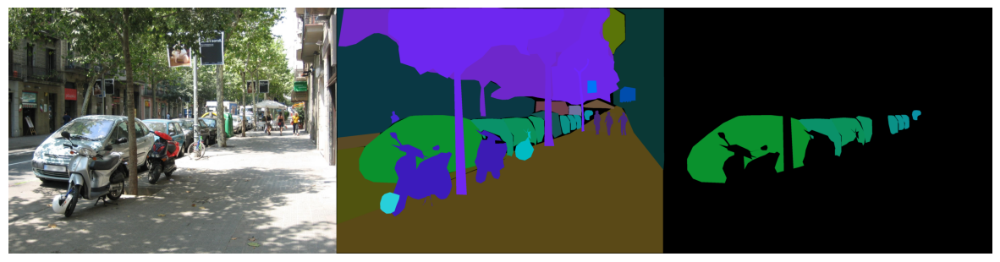

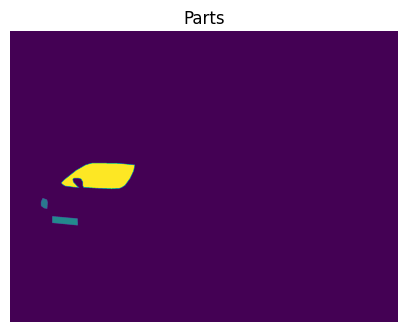

In [8]:
root_path = DATASET_PATH

# This function reads the image and mask files and generate instance and segmentation
# masks
info = utils_ade20k.loadAde20K('{}\{}'.format(root_path, full_file_name))
img = cv2.imread(info['img_name'])[:,:,::-1]
seg = cv2.imread(info['segm_name'])[:,:,::-1]
seg_mask = seg.copy()

# The 0 index in seg_mask corresponds to background (not annotated) pixels
seg_mask[info['class_mask'] != obj_id+1] *= 0
plt.figure(figsize=(15,5))

plt.imshow(np.concatenate([img, seg, seg_mask], 1))
plt.axis('off')
if len(info['partclass_mask']):
    plt.figure(figsize=(5*len(info['partclass_mask']), 5))
    plt.title('Parts')
    plt.imshow(np.concatenate(info['partclass_mask'],1))
    plt.axis('off')

(-0.5, 2199.5, 1649.5, -0.5)

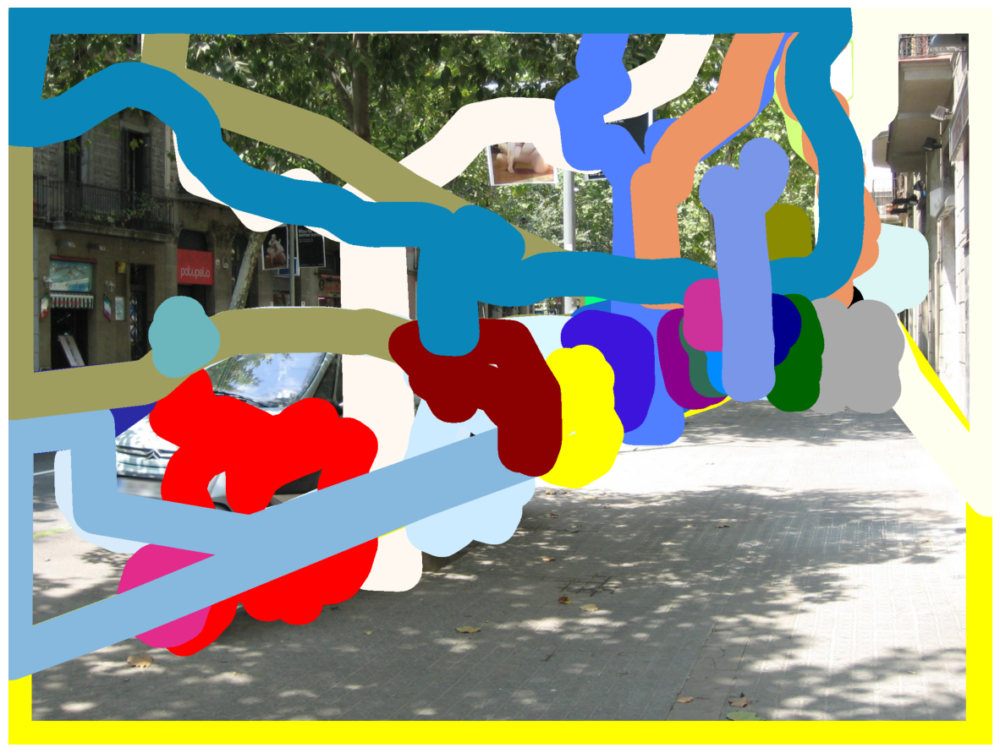

In [14]:
#Plotting Segmentation mask
img = plot_polygon('{}/{}'.format(root_path, full_file_name), info)
plt.figure(figsize=(15,15))
plt.imshow(img[:, :, ::-1])
plt.axis('off')

In [12]:
from PIL import Image
import matplotlib._color_data as mcd
import cv2
import ipdb
import json
import numpy as np
import os

_NUMERALS = '0123456789abcdefABCDEF'
_HEXDEC = {v: int(v, 16) for v in (x+y for x in _NUMERALS for y in _NUMERALS)}
LOWERCASE, UPPERCASE = 'x', 'X'
def rgb(triplet):
    return _HEXDEC[triplet[0:2]], _HEXDEC[triplet[2:4]], _HEXDEC[triplet[4:6]]

def loadAde20K(file):
    fileseg = file.replace('.jpg', '_seg.png');
    with Image.open(fileseg) as io:
        seg = np.array(io);

    # Obtain the segmentation mask, bult from the RGB channels of the _seg file
    R = seg[:,:,0];
    G = seg[:,:,1];
    B = seg[:,:,2];
    ObjectClassMasks = (R/10).astype(np.int32)*256+(G.astype(np.int32));


    # Obtain the instance mask from the blue channel of the _seg file
    Minstances_hat = np.unique(B, return_inverse=True)[1]
    Minstances_hat = np.reshape(Minstances_hat, B.shape)
    ObjectInstanceMasks = Minstances_hat


    level = 0
    PartsClassMasks = [];
    PartsInstanceMasks = [];
    while True:
        level = level+1;
        file_parts = file.replace('.jpg', '_parts_{}.png'.format(level));
        if os.path.isfile(file_parts):
            with Image.open(file_parts) as io:
                partsseg = np.array(io);
            R = partsseg[:,:,0];
            G = partsseg[:,:,1];
            B = partsseg[:,:,2];
            PartsClassMasks.append((np.int32(R)/10)*256+np.int32(G));
            PartsInstanceMasks = PartsClassMasks
            # TODO:  correct partinstancemasks

            
        else:
            break

    objects = {}
    parts = {}

    attr_file_name = file.replace('.jpg', '.json')
    if os.path.isfile(attr_file_name):
        with open(attr_file_name, 'r') as f:
            input_info = json.load(f)

        contents = input_info['annotation']['object']
        instance = np.array([int(x['id']) for x in contents])
        names = [x['raw_name'] for x in contents]
        corrected_raw_name =  [x['name'] for x in contents]
        partlevel = np.array([int(x['parts']['part_level']) for x in contents])
        ispart = np.array([p>0 for p in partlevel])
        iscrop = np.array([int(x['crop']) for x in contents])
        listattributes = [x['attributes'] for x in contents]
        polygon = [x['polygon'] for x in contents]
        for p in polygon:
            p['x'] = np.array(p['x'])
            p['y'] = np.array(p['y'])

        objects['instancendx'] = instance[ispart == 0]
        objects['class'] = [names[x] for x in list(np.where(ispart == 0)[0])]
        objects['corrected_raw_name'] = [corrected_raw_name[x] for x in list(np.where(ispart == 0)[0])]
        objects['iscrop'] = iscrop[ispart == 0]
        objects['listattributes'] = [listattributes[x] for x in list(np.where(ispart == 0)[0])]
        objects['polygon'] = [polygon[x] for x in list(np.where(ispart == 0)[0])]


        parts['instancendx'] = instance[ispart == 1]
        parts['class'] = [names[x] for x in list(np.where(ispart == 1)[0])]
        parts['corrected_raw_name'] = [corrected_raw_name[x] for x in list(np.where(ispart == 1)[0])]
        parts['iscrop'] = iscrop[ispart == 1]
        parts['listattributes'] = [listattributes[x] for x in list(np.where(ispart == 1)[0])]
        parts['polygon'] = [polygon[x] for x in list(np.where(ispart == 1)[0])]

    return {'img_name': file, 'segm_name': fileseg,
            'class_mask': ObjectClassMasks, 'instance_mask': ObjectInstanceMasks, 
            'partclass_mask': PartsClassMasks, 'part_instance_mask': PartsInstanceMasks, 
            'objects': objects, 'parts': parts}

def plot_polygon(img_name, info, show_obj=True, show_parts=False):
    colors = mcd.CSS4_COLORS
    color_keys = list(colors.keys())
    all_objects = []
    all_poly = []
    if show_obj:
        all_objects += info['objects']['class']
        all_poly += info['objects']['polygon']
    if show_parts:
        all_objects += info['parts']['class']
        all_poly += info['objects']['polygon']

    img = cv2.imread(img_name)
    thickness = 100
    for it, (obj, poly) in enumerate(zip(all_objects, all_poly)):
        curr_color = colors[color_keys[it % len(color_keys)] ]
        pts = np.concatenate([poly['x'][:, None], poly['y'][:, None]], 1)[None, :]
        color = rgb(curr_color[1:])
        img = cv2.polylines(img, pts, True, color, thickness)
    return img



# Undersatnding Color Coding and number of traing and validation records specific to category 

In [11]:
eda_df_data = pd.read_excel("D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\color_coding_semantic_segmentation_classes.xlsx")
eda_df_data

,Idx,Ratio,Train,Val,Stuff,"Color_Code (R,G,B)",Color_Code(hex),Color,Name
0,1,0.1576,11664,1172,1,"(120, 120, 120)",#787878,NaN,wall
1,2,0.1072,6046,612,1,"(180, 120, 120)",#B47878,NaN,building;edifice
2,3,0.0878,8265,796,1,"(6, 230, 230)",#06E6E6,NaN,sky
3,4,0.0621,9336,917,1,"(80, 50, 50)",#503232,NaN,floor;flooring
4,5,0.0480,6678,641,0,"(4, 200, 3)",#04C803,NaN,tree
...,...,...,...,...,...,...,...,...,...
145,146,0.0003,130,14,0,"(0, 133, 255)",#0085FF,NaN,shower
146,147,0.0003,178,28,0,"(255, 214, 0)",#FFD600,NaN,radiator
147,148,0.0002,504,57,0,"(25, 194, 194)",#19C2C2,NaN,glass;drinking;glass
148,149,0.0002,775,96,0,"(102, 255, 0)",#66FF00,NaN,clock


In [12]:
eda_df_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150 entries, 0 to 149
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Idx                 150 non-null    int64  
 1   Ratio               150 non-null    float64
 2   Train               150 non-null    int64  
 3   Val                 150 non-null    int64  
 4   Stuff               150 non-null    int64  
 5   Color_Code (R,G,B)  150 non-null    object 
 6   Color_Code(hex)     150 non-null    object 
 7   Color               0 non-null      float64
 8   Name                150 non-null    object 
dtypes: float64(2), int64(4), object(3)
memory usage: 10.7+ KB


## Training Data

In [12]:
final_df = eda_df_data.sort_values(by=['Train'], ascending=False)
final_df

,Idx,Ratio,Train,Val,Stuff,"Color_Code (R,G,B)",Color_Code(hex),Color,Name
0,1,0.1576,11664,1172,1,"(120, 120, 120)",#787878,NaN,wall
3,4,0.0621,9336,917,1,"(80, 50, 50)",#503232,NaN,floor;flooring
2,3,0.0878,8265,796,1,"(6, 230, 230)",#06E6E6,NaN,sky
4,5,0.0480,6678,641,0,"(4, 200, 3)",#04C803,NaN,tree
14,15,0.0118,6666,796,0,"(8, 255, 51)",#08FF33,NaN,door;double;door
...,...,...,...,...,...,...,...,...,...
105,106,0.0005,57,4,1,"(133, 0, 255)",#8500FF,NaN,conveyer;belt;conveyor;belt;conveyer;conveyor;...
128,129,0.0004,52,5,1,"(10, 190, 212)",#0ABED4,NaN,lake
103,104,0.0006,52,4,0,"(255, 235, 0)",#FFEB00,NaN,ship
111,112,0.0005,50,4,0,"(255, 0, 112)",#FF0070,NaN,barrel;cask


In [13]:
colors = final_df["Color_Code(hex)"]
colors

0      #787878
3      #503232
2      #06E6E6
4      #04C803
14     #08FF33
        ...   
105    #8500FF
128    #0ABED4
103    #FFEB00
111    #FF0070
96     #00FFA3
Name: Color_Code(hex), Length: 150, dtype: object

In [14]:
Label = list(final_df["Name"])
Name =[]

for i in Label:
    Name.append(i)

print(*Name,sep="\n")

wall
floor;flooring
sky
tree
door;double;door
ceiling
building;edifice
person;individual;someone;somebody;mortal;soul
windowpane;window
table
road;route
plant;flora;plant;life
painting;picture
chair
car;auto;automobile;machine;motorcar
lamp
sidewalk;pavement
cabinet
signboard;sign
light;light;source
grass
curtain;drape;drapery;mantle;pall
streetlight;street;lamp
bed
mirror
earth;ground
mountain;mount
shelf
cushion
box
fence;fencing
flower
seat
vase
pot;flowerpot
sofa;couch;lounge
sink
armchair
rug;carpet;carpeting
book
sconce
pole
bottle
pillow
stairs;steps
railing;rail
column;pillar
coffee;table;cocktail;table
rock;stone
clock
water
desk
ashcan;trash;can;garbage;can;wastebin;ash;bin;ash-bin;ashbin;dustbin;trash;barrel;trash;bin
house
bench
sea
basket;handbasket
television;television;receiver;television;set;tv;tv;set;idiot;box;boob;tube;telly;goggle;box
chandelier;pendant;pendent
plate
stairway;staircase
path
van
chest;of;drawers;chest;bureau;dresser
awning;sunshade;sunblind
stove;kitc

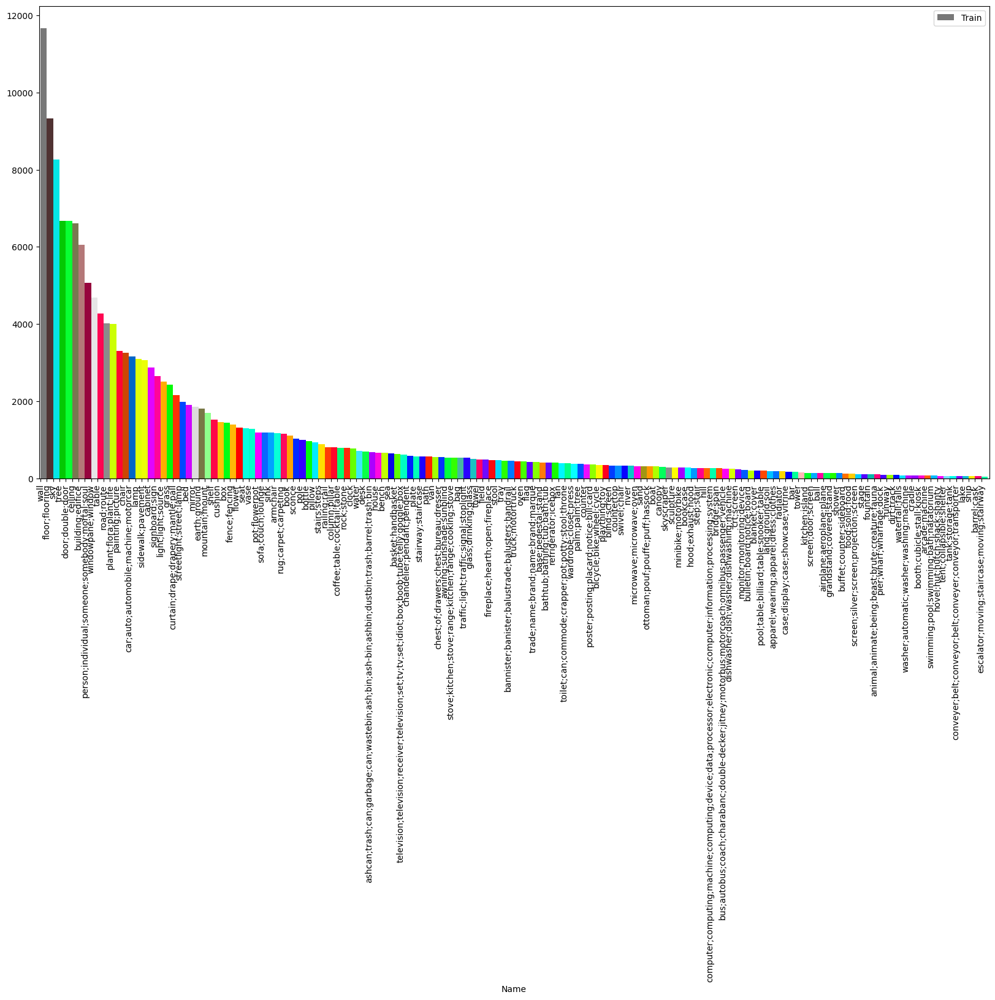

In [15]:
final_df.plot.bar(x="Name",y="Train",color=colors,figsize = (20, 10),width=1, align='edge')
plt.show()

In [16]:
final_df.describe()

,Idx,Ratio,Train,Val,Stuff,Color
count,150.000000,150.000000,150.000000,150.000000,150.000000,0.0
mean,75.500000,0.006183,1139.493333,117.673333,0.233333,NaN
std,43.445368,0.018636,1842.597717,185.878379,0.424370,NaN
min,1.000000,0.000200,42.000000,3.000000,0.000000,NaN
25%,38.250000,0.000500,208.750000,22.250000,0.000000,NaN
50%,75.500000,0.001050,446.000000,49.000000,0.000000,NaN
75%,112.750000,0.002400,1168.500000,113.750000,0.000000,NaN
max,150.000000,0.157600,11664.000000,1172.000000,1.000000,NaN


## Validation Data

In [17]:
final_df_Val = eda_df_data.sort_values(by=['Val'], ascending=False)
final_df_Val.describe()

,Idx,Ratio,Train,Val,Stuff,Color
count,150.000000,150.000000,150.000000,150.000000,150.000000,0.0
mean,75.500000,0.006183,1139.493333,117.673333,0.233333,NaN
std,43.445368,0.018636,1842.597717,185.878379,0.424370,NaN
min,1.000000,0.000200,42.000000,3.000000,0.000000,NaN
25%,38.250000,0.000500,208.750000,22.250000,0.000000,NaN
50%,75.500000,0.001050,446.000000,49.000000,0.000000,NaN
75%,112.750000,0.002400,1168.500000,113.750000,0.000000,NaN
max,150.000000,0.157600,11664.000000,1172.000000,1.000000,NaN


In [18]:
final_df_Val

,Idx,Ratio,Train,Val,Stuff,"Color_Code (R,G,B)",Color_Code(hex),Color,Name
0,1,0.1576,11664,1172,1,"(120, 120, 120)",#787878,NaN,wall
3,4,0.0621,9336,917,1,"(80, 50, 50)",#503232,NaN,floor;flooring
2,3,0.0878,8265,796,1,"(6, 230, 230)",#06E6E6,NaN,sky
14,15,0.0118,6666,796,0,"(8, 255, 51)",#08FF33,NaN,door;double;door
5,6,0.0450,6604,643,1,"(120, 120, 80)",#787850,NaN,ceiling
...,...,...,...,...,...,...,...,...,...
105,106,0.0005,57,4,1,"(133, 0, 255)",#8500FF,NaN,conveyer;belt;conveyor;belt;conveyer;conveyor;...
111,112,0.0005,50,4,0,"(255, 0, 112)",#FF0070,NaN,barrel;cask
103,104,0.0006,52,4,0,"(255, 235, 0)",#FFEB00,NaN,ship
114,115,0.0005,59,3,0,"(112, 224, 255)",#70E0FF,NaN,tent;collapsible;shelter


In [19]:
colors = final_df_Val["Color_Code(hex)"]
colors

0      #787878
3      #503232
2      #06E6E6
14     #08FF33
5      #787850
        ...   
105    #8500FF
111    #FF0070
103    #FFEB00
114    #70E0FF
109    #00B8FF
Name: Color_Code(hex), Length: 150, dtype: object

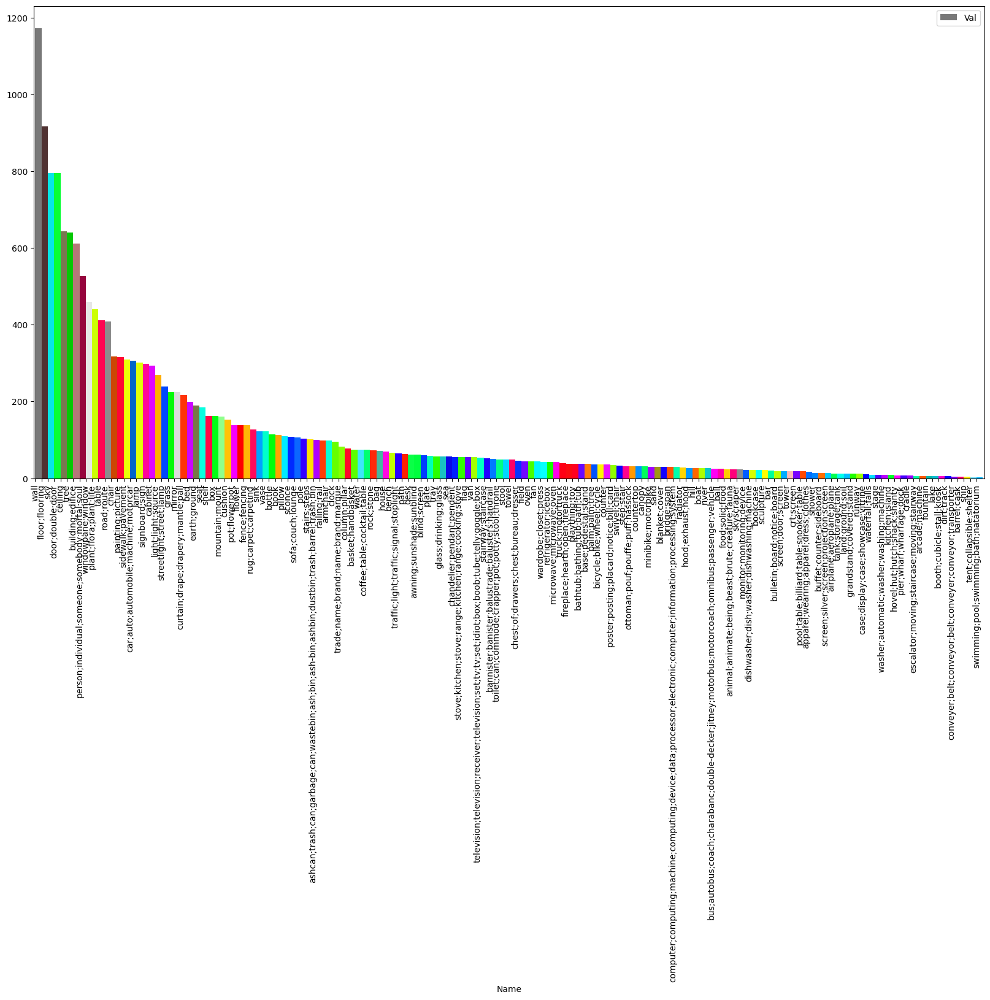

In [20]:
final_df_Val.plot.bar(x="Name",y="Val",color=colors,figsize = (20, 10),width=1, align='edge')
plt.show()

## Dataset Details

In [21]:
import os

General_path = r"D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training"
General_categories = os.listdir(General_path)

categories = {}

for i in General_categories:
    new_path = os.path.join(General_path,i)
    General_sub_categories = os.listdir(new_path)
    categories[i] = General_sub_categories
print(categories)


{'cultural': ['apse__indoor', 'aquarium', 'arcade', 'archive', 'armory', 'artists_loft', 'art_gallery', 'art_school', 'art_studio', 'auditorium', 'baptistry__indoor', 'belfry', 'bomb_shelter__indoor', 'burial_chamber', 'catacomb', 'cathedral__indoor', 'catwalk', 'chapel', 'choir_loft__exterior', 'choir_loft__interior', 'church__indoor', 'classroom', 'clock_tower__indoor', 'cloister__indoor', 'conference_center', 'confessional', 'courtroom', 'day_care_center', 'funeral_chapel', 'funeral_home', 'gun_deck__indoor', 'jail_cell', 'jail__indoor', 'jury_box', 'kindergarden_classroom', 'lab_classroom', 'lecture_room', 'legislative_chamber', 'library__indoor', 'monastery__indoor', 'morgue', 'mosque__indoor', 'movie_theater__indoor', 'museum__indoor', 'music_studio', 'natural_history_museum', 'organ_loft__exterior', 'organ_loft__interior', 'ossuary', 'planetarium__indoor', 'podium__indoor', 'pulpit', 'sacristy', 'science_museum', 'scriptorium', 'shrine', 'stage__indoor', 'synagogue__indoor', 'te

In [22]:
for k,v in categories.items():
    print(k,"\n ===================================================================\n",v)

cultural 
 ['apse__indoor', 'aquarium', 'arcade', 'archive', 'armory', 'artists_loft', 'art_gallery', 'art_school', 'art_studio', 'auditorium', 'baptistry__indoor', 'belfry', 'bomb_shelter__indoor', 'burial_chamber', 'catacomb', 'cathedral__indoor', 'catwalk', 'chapel', 'choir_loft__exterior', 'choir_loft__interior', 'church__indoor', 'classroom', 'clock_tower__indoor', 'cloister__indoor', 'conference_center', 'confessional', 'courtroom', 'day_care_center', 'funeral_chapel', 'funeral_home', 'gun_deck__indoor', 'jail_cell', 'jail__indoor', 'jury_box', 'kindergarden_classroom', 'lab_classroom', 'lecture_room', 'legislative_chamber', 'library__indoor', 'monastery__indoor', 'morgue', 'mosque__indoor', 'movie_theater__indoor', 'museum__indoor', 'music_studio', 'natural_history_museum', 'organ_loft__exterior', 'organ_loft__interior', 'ossuary', 'planetarium__indoor', 'podium__indoor', 'pulpit', 'sacristy', 'science_museum', 'scriptorium', 'shrine', 'stage__indoor', 'synagogue__indoor', 'tele

In [23]:
pwd

'D:\\Grad Project\\Code\\Scene-Parsing'

In [24]:
len(list(categories.values()))

10

In [25]:
data_images = pd.DataFrame(categories.items(),columns=["Category","SubCategory"])

In [26]:
data_images


,Category,SubCategory
0,cultural,"[apse__indoor, aquarium, arcade, archive, armo..."
1,home_or_hotel,"[alcove, atrium__home, attic, barrack, basemen..."
2,industrial,"[brickyard__outdoor, chemical_plant, construct..."
3,nature_landscape,"[badlands, bamboo_forest, bayou, beach, boardw..."
4,shopping_and_dining,"[auto_showroom, bakery__kitchen, bakery__shop,..."
5,sports_and_leisure,"[amusement_arcade, amusement_park, aquatic_the..."
6,transportation,"[airlock, airplane_cabin, airport_terminal, ai..."
7,unclassified,"[athletic_field_outdoor, balcony_exterior, bal..."
8,urban,"[abbey, access_road, airfield, airport__airpor..."
9,work_place,"[anechoic_chamber, assembly_line, atrium__publ..."


In [27]:

for root, dirs, files in os.walk(General_path, topdown=True):
    print(len(dirs))
    if len(dirs)!=0:
        for cat in range(len(dirs)):
            General_categories.append(dirs[cat])
        print(General_categories) 
        
    """for name in files:
        print(os.path.join(root, name))
        
    for name in dirs:
        print(os.path.join(root, name))"""
        
list(os.walk(General_path, topdown=True))

10
['cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place']
67
['cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'apse__indoor', 'aquarium', 'arcade', 'archive', 'armory', 'artists_loft', 'art_gallery', 'art_school', 'art_studio', 'auditorium', 'baptistry__indoor', 'belfry', 'bomb_shelter__indoor', 'burial_chamber', 'catacomb', 'cathedral__indoor', 'catwalk', 'chapel', 'choir_loft__exterior', 'choir_loft__interior', 'church__indoor', 'classr

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
20
['cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'apse__indoor', 'aquarium', 'arcade', 'archive', 'armory', 'artists_loft', 'art_gallery', 'art_school', 'art_studio', 'auditorium', 'baptistry__indoor', 'belfry', 'bomb_shelter__indoor', 'burial_chamber', 'catacomb', 'cathedral__indoor', 'catwalk', 'chapel', 'choir_loft__exterior', 'choir_loft__interior', 'church__indoor', 'classroom', 'clock_tower__indoor', 'cloister__indoor', 'conference_center', 'confessional', 'courtroom', 'day_care_center', 'funer

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
['cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'apse__indoor', 'aquarium', 'arcade', 'archive', 'armory', 'artists_loft', 'art_gallery', 'art_school', 'art_studio', 'auditorium', 'baptistry__indoor', 'belfry', 'bomb_shelter__indoor', 'burial_chamber', 'catacomb', 'cathedral__indoor', 'catwalk', 'chapel', 'choir_loft__exterior', 'choir_loft__interior', 'church__indoor', 'classroom', 'clock_tower__indoor', 'cloister__indoor', 'conferen

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
0
0
0
4
['cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'apse__indoor', 'aquarium', 'arcade', 'archive', 'armory', 'artists_loft', 'art_gallery', 'art_school', 'art_studio', 'auditorium', 'baptistry__indoor', 'belfry', 'bomb_shelter__indoor', 'burial_chamber', 'catacomb', 'cathedral__indoor', 'catwalk', 'chapel', 'choir_loft__exterior', 'choir_loft__interior', 'church__indoor', 'classroom', 'clock_tower__indoor', 'cloister__indoor', 'conference_center', 'confessional', 'courtroom', 'day_care_center', 'funeral_chapel', 'funeral_home', 'gun_deck__indoor', 'jail_cell', 'jail__indoor', 'jury_box', 'kindergarden_classroom', 'lab_classroom', 'lecture_room', 'legislative_chamber', 'library__indoor

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
0
0
0
6
['cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'apse__indoor', 'aquarium', 'arcade', 'archive', 'armory', 'artists_loft', 'art_gallery', 'art_school', 'art_studio', 'auditorium', 'baptistry__indoor', 'belfry', 'bomb_shelter__indoor', 'burial_chamber', 'catacomb', 'cathedral__indoor', 'catwalk', 'chapel', 'choir_loft__exterior', 'choir_loft__interior', 'church__indoor', 'classroom', 'clock_tower__indoor', 'cloister__indoor', 'conference_center', 'confessional', 'courtroom', 'day_care_center', 'funeral_chapel', 'funeral_home', 'gun_deck__indoor', 'jail_cell', 'jail__indoor', 'jury_box', 'kindergarden_classroom', 'lab_classroom', 'lecture_room', 'legislative_chamber', 'library__indoor

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
0
0
27
['cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'apse__indoor', 'aquarium', 'arcade', 'archive', 'armory', 'artists_loft', 'art_gallery', 'art_school', 'art_studio', 'auditorium', 'baptistry__indoor', 'belfry', 'bomb_shelter__indoor', 'burial_chamber', 'catacomb', 'cathedral__indoor', 'catwalk', 'chapel', 'choir_loft__exterior', 'choir_loft__interior', 'church__indoor', 'classroom', 'clock_tower__indoor', 'cloister__indoor', 'conference_center', 'confessional', 'courtroom', 'day_care_center', 'funeral_chapel', 'funeral_home', 'gun_deck__indoor', 'jail_cell', 'jail__indoor', 'jury_box', 'kindergarden_classroom', 'lab_classroom', 'lecture_room', 'legislative_chamber', 'library__indoor'

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
38
['cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'apse__indoor', 'aquarium', 'arcade', 'archive', 'armory', 'artists_loft', 'art_gallery', 'art_school', 'art_studio', 'auditorium', 'baptistry__indoor', 'belfry', 'bomb_shelter__indoor', 'burial_chamber', 'catacomb', 'cathedral__indoor', 'catwalk', 'chapel', 'choir_loft__exterior', 'choir_loft__interior', 'church__indoor', 'classroom', 'clock_tower__indoor', 'cloister__indoor', 'conference_center', 'confessional', 'courtroom', 'day_care_center', 'funeral_chapel', 'funeral_home', 'gun_deck__indoor', 'jail_cell', 'jail__indoor', 'jury_box', 'kindergarden_classroom', 'lab_classroom', 'lecture_room', 'legislative_chamber', 'library__indoor', 'm

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
30
['cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'apse__indoor', 'aquarium', 'arcade', 'archive', 'armory', 'artists_loft', 'art_gallery', 'art_school', 'art_studio', 'auditorium', 'baptistry__indoor', 'belfry', 'bomb_shelter__indoor', 'burial_chamber', 'catacomb', 'cathedral__indoor', 'catwalk', 'chapel', 'choir_loft__exterior', 'choir_loft__interior', 'church__indoor', 'classroom', 'clock_tower__indoor', 'cloister__indoor', 'conference_center', 'confessional', 'courtroom', 'day_care_center', 'funeral_chapel', 'funeral_home', 'gun_deck__indoor', 'jail_cell', 'jail__indoor', 'jury_box', 'kindergarden_cla

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3
['cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'cultural', 'home_or_hotel', 'in

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
8
['cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'cultural', 'home_or_hotel', 'industrial', 'nature_landscape', 'shopping_and_dining', 'sports_and_leisure', 'transportation', 'unclassified', 'urban', 'work_place', 'apse__indoor', 'aquarium', 'arcade', 'archive', 'armory', 'artists_loft', 'art_gallery', 'art_school', 'art_studio', 'auditorium', 'baptistry__indoor', 'belfry', 'bomb_shelter__indoor', 'burial_chamber', 'catacomb', 'cathedral__indoor', 'catwal

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[('D:\\Dataset\\snehalb06_739a88df\\ADE20K_2021_17_01\\images\\ADE\\training',
  ['cultural',
   'home_or_hotel',
   'industrial',
   'nature_landscape',
   'shopping_and_dining',
   'sports_and_leisure',
   'transportation',
   'unclassified',
   'urban',
   'work_place'],
  []),
 ('D:\\Dataset\\snehalb06_739a88df\\ADE20K_2021_17_01\\images\\ADE\\training\\cultural',
  ['apse__indoor',
   'aquarium',
   'arcade',
   'archive',
   'armory',
   'artists_loft',
   'art_gallery',
   'art_school',
   'art_studio',
   'auditorium',
   'baptistry__indoor',
   'belfry',
   'bomb_shelter__indoor',
   'burial_chamber',
   'catacomb',
   'cathedral__indoor',
   'catwalk',
   'chapel',
   'choir_loft__exterior',
   'choir_loft__interior',
   'church__indoor',
   'classroom',
   'clock_tower__indoor',
   'cloister__indoor',
   'conference_center',
   'confessional',
   'courtroom',
   'day_care_center',
   'funeral_chapel',
   'funeral_home',
   'gun_deck__indoor',
   'jail_cell',
   'jail__indoor

## General Categories : 
['cultural',
   'home_or_hotel',
   'industrial',
   'nature_landscape',
   'shopping_and_dining',
   'sports_and_leisure',
   'transportation',
   'unclassified',
   'urban',
   'wor

## Cultural:
['apse__indoor',
   'aquarium',
   'arcade',
   'archive',
   'armory',
   'artists_loft',
   'art_gallery',
   'art_school',
   'art_studio',
   'auditorium',
   'baptistry__indoor',
   'belfry',
   'bomb_shelter__indoor',
   'burial_chamber',
   'catacomb',
   'cathedral__indoor',
   'catwalk',
   'chapel',
   'choir_loft__exterior',
   'choir_loft__interior',
   'church__indoor',
   'classroom',
   'clock_tower__indoor',
   'cloister__indoor',
   'conference_center',
   'confessional',
   'courtroom',
   'day_care_center',
   'funeral_chapel',
   'funeral_home',
   'gun_deck__indoor',
   'jail_cell',
   'jail__indoor',
   'jury_box',
   'kindergarden_classroom',
   'lab_classroom',
   'lecture_room',
   'legislative_chamber',
   'library__indoor',
   'monastery__indoor',
   'morgue',
   'mosque__indoor',
   'movie_theater__indoor',
   'museum__indoor',
   'music_studio',
   'natural_history_museum',
   'organ_loft__exterior',
   'organ_loft__interior',
   'ossuary',
   'planetarium__indoor',
   'podium__indoor',
   'pulpit',
   'sacristy',
   'science_museum',
   'scriptorium',
   'shrine',
   'stage__indoor',
   'synagogue__indoor',
   'television_studio',
   'theater__indoor_procenium',
   'theater__indoor_seats',
   'throne_room',
   'ticket_booth',
   'vestry',]


   'voting_booth',
   'whispering_gallery',
   'witness_stand'k_place']

In [28]:
os.listdir(General_path)

['cultural',
 'home_or_hotel',
 'industrial',
 'nature_landscape',
 'shopping_and_dining',
 'sports_and_leisure',
 'transportation',
 'unclassified',
 'urban',
 'work_place']

In [29]:
subCat =  os.listdir(General_path)

In [30]:
list(os.scandir(General_path))

[<DirEntry 'cultural'>,
 <DirEntry 'home_or_hotel'>,
 <DirEntry 'industrial'>,
 <DirEntry 'nature_landscape'>,
 <DirEntry 'shopping_and_dining'>,
 <DirEntry 'sports_and_leisure'>,
 <DirEntry 'transportation'>,
 <DirEntry 'unclassified'>,
 <DirEntry 'urban'>,
 <DirEntry 'work_place'>]

# Making dataframe with folder, path, category, subcategory and segmentation mask detail

In [31]:
import glob
subFolders = {}
segmentation = {}
for i in subCat: 
    k = os.listdir(General_path+'/'+str(i))
    for j in k:
        images = []
        segment = []
        inside_folder = os.listdir(General_path+'/'+str(i)+'/'+str(j)+'/')
        for m in inside_folder:
            if m.endswith("_seg.png"):
                segment.append(m)
            if m.endswith(".jpg"):
                images.append(m)
        subFolders[General_path+'/'+str(i)+'/'+str(j)+'/'] = images
        segmentation[General_path+'/'+str(i)+'/'+str(j)+'/'] = segment

In [32]:
#Printing Subfolders
sub = list(subFolders.keys())
print(*sub,sep="\n",end="\n")

D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/apse__indoor/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/aquarium/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/arcade/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/archive/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/armory/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/artists_loft/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/art_gallery/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/art_school/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/art_studio/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/auditorium/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/baptistry__indoor/
D:\Dataset\snehalb06_7

In [33]:
#Printing Image Names
sub = list(subFolders.values())
print(*sub,sep="\n",end="\n")

['ADE_train_00001472.jpg', 'ADE_train_00001473.jpg', 'ADE_train_00001474.jpg', 'ADE_train_00001475.jpg', 'ADE_train_00001476.jpg', 'ADE_train_00001477.jpg', 'ADE_train_00001478.jpg', 'ADE_train_00001479.jpg', 'ADE_train_00001480.jpg', 'ADE_train_00001481.jpg']
['ADE_frame_00000007.jpg', 'ADE_train_00001488.jpg', 'ADE_train_00001489.jpg', 'ADE_train_00001490.jpg', 'ADE_train_00001491.jpg', 'ADE_train_00001492.jpg', 'ADE_train_00001493.jpg', 'ADE_train_00001494.jpg', 'ADE_train_00001495.jpg', 'ADE_train_00020233.jpg', 'ADE_train_00022632.jpg', 'ADE_train_00022633.jpg', 'ADE_train_00022634.jpg', 'ADE_train_00022635.jpg', 'ADE_train_00022636.jpg']
['ADE_train_00001522.jpg', 'ADE_train_00001523.jpg', 'ADE_train_00001524.jpg', 'ADE_train_00001525.jpg', 'ADE_train_00001526.jpg', 'ADE_train_00022645.jpg', 'ADE_train_00022646.jpg', 'ADE_train_00022647.jpg', 'ADE_train_00022648.jpg', 'ADE_train_00022649.jpg']
['ADE_train_00001549.jpg', 'ADE_train_00001550.jpg', 'ADE_train_00001551.jpg', 'ADE_tra

In [34]:
#Printing Segmmentation Mask 
seg = list(segmentation.keys())
print(*seg,sep="\n",end="\n")

D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/apse__indoor/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/aquarium/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/arcade/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/archive/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/armory/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/artists_loft/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/art_gallery/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/art_school/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/art_studio/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/auditorium/
D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/baptistry__indoor/
D:\Dataset\snehalb06_7

In [35]:
seg = list(segmentation.values())
print(*seg,sep="\n",end="\n")

['ADE_train_00001472_seg.png', 'ADE_train_00001473_seg.png', 'ADE_train_00001474_seg.png', 'ADE_train_00001475_seg.png', 'ADE_train_00001476_seg.png', 'ADE_train_00001477_seg.png', 'ADE_train_00001478_seg.png', 'ADE_train_00001479_seg.png', 'ADE_train_00001480_seg.png', 'ADE_train_00001481_seg.png']
['ADE_frame_00000007_seg.png', 'ADE_train_00001488_seg.png', 'ADE_train_00001489_seg.png', 'ADE_train_00001490_seg.png', 'ADE_train_00001491_seg.png', 'ADE_train_00001492_seg.png', 'ADE_train_00001493_seg.png', 'ADE_train_00001494_seg.png', 'ADE_train_00001495_seg.png', 'ADE_train_00020233_seg.png', 'ADE_train_00022632_seg.png', 'ADE_train_00022633_seg.png', 'ADE_train_00022634_seg.png', 'ADE_train_00022635_seg.png', 'ADE_train_00022636_seg.png']
['ADE_train_00001522_seg.png', 'ADE_train_00001523_seg.png', 'ADE_train_00001524_seg.png', 'ADE_train_00001525_seg.png', 'ADE_train_00001526_seg.png', 'ADE_train_00022645_seg.png', 'ADE_train_00022646_seg.png', 'ADE_train_00022647_seg.png', 'ADE_tr

In [36]:
#creating a new dataframe 
df = pd.DataFrame(columns = ['Index', 'SubFolder','Image','category','subCategory'])
print(df)

Empty DataFrame
Columns: [Index, SubFolder, Image, category, subCategory]
Index: []


In [37]:
path = 'D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_01\images\ADE\training/cultural/cathedral__indoor/'
print(path.split('/'))

['D:\\Dataset\\snehalb06_739a88df\\ADE20K_2021_17_01\\images\\ADE\training', 'cultural', 'cathedral__indoor', '']


In [38]:
#Function to get Category and subcategory from folder path
def getCatSub(path):
    return path.split('/')[1] , path.split('/')[2]
    

In [39]:
#Adding Data to dataframe
i=1
cat = []
old_path = list(subFolders.keys())[0]
cat,sub = cat, sub = getCatSub(old_path)
for k,v in subFolders.items():
    new_path = k
    for z in range(len(v)):
        if old_path != new_path:
            old_path = new_path
            cat, sub = getCatSub(new_path)
        df.loc[i] = [i,k, v[z],cat,sub]
        i+=1

In [40]:
df

,Index,SubFolder,Image,category,subCategory
1,1,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00001472.jpg,cultural,apse__indoor
2,2,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00001473.jpg,cultural,apse__indoor
3,3,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00001474.jpg,cultural,apse__indoor
4,4,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00001475.jpg,cultural,apse__indoor
5,5,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00001476.jpg,cultural,apse__indoor
...,...,...,...,...,...
25570,25570,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00020107.jpg,work_place,workshop
25571,25571,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00020108.jpg,work_place,workshop
25572,25572,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00020109.jpg,work_place,workshop
25573,25573,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00020110.jpg,work_place,workshop


In [182]:
#grouping by subcategory
df.groupby(['subCategory'])['subCategory'].count().sort_values(ascending=False).head(60)

subCategory
street                         2060
misc                           1663
bedroom                        1476
living_room                    1001
kitchen                         789
bathroom                        705
dining_room                     494
skyscraper                      415
highway                         316
mountain_snowy                  289
building_facade                 249
hotel_room                      241
conference_room                 211
mountain                        168
waterfall__fan                  144
corridor                        143
beach                           138
coast                           131
office                          129
forest__broadleaf               123
airport_terminal                112
art_studio                      110
home_office                     110
park                            106
waiting_room                    106
lobby                           104
poolroom__home                  100
game_room       

In [ ]:
df.plot.barh(x='subCategory',figsize = (10, 20),width=0.5, align='center')

In [41]:
#Dataframe for segmentation mask
df_seg = pd.DataFrame(columns = ['SubFolder','seg',])
print(df_seg)

Empty DataFrame
Columns: [SubFolder, seg]
Index: []


In [42]:
#Adding data to segmentation dataframe
i=1
for k,v in segmentation.items():
    for z in range(len(v)):
        df_seg.loc[i] = [k, v[z]]
        i+=1
print(df_seg)

                                               SubFolder  \
1      D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...   
2      D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...   
3      D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...   
4      D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...   
5      D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...   
...                                                  ...   
25570  D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...   
25571  D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...   
25572  D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...   
25573  D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...   
25574  D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...   

                              seg  
1      ADE_train_00001472_seg.png  
2      ADE_train_00001473_seg.png  
3      ADE_train_00001474_seg.png  
4      ADE_train_00001475_seg.png  
5      ADE_train_00001476_seg.png  
...                           ...  
25570  ADE_train_00020107_s

In [43]:
#Adding segmentaion mask image details to old dataframe
df = df.assign(seg=df_seg['seg'])

In [44]:
df

,Index,SubFolder,Image,category,subCategory,seg
1,1,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00001472.jpg,cultural,apse__indoor,ADE_train_00001472_seg.png
2,2,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00001473.jpg,cultural,apse__indoor,ADE_train_00001473_seg.png
3,3,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00001474.jpg,cultural,apse__indoor,ADE_train_00001474_seg.png
4,4,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00001475.jpg,cultural,apse__indoor,ADE_train_00001475_seg.png
5,5,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00001476.jpg,cultural,apse__indoor,ADE_train_00001476_seg.png
...,...,...,...,...,...,...
25570,25570,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00020107.jpg,work_place,workshop,ADE_train_00020107_seg.png
25571,25571,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00020108.jpg,work_place,workshop,ADE_train_00020108_seg.png
25572,25572,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00020109.jpg,work_place,workshop,ADE_train_00020109_seg.png
25573,25573,D:\Dataset\snehalb06_739a88df\ADE20K_2021_17_0...,ADE_train_00020110.jpg,work_place,workshop,ADE_train_00020110_seg.png


In [45]:
#Class Distribution
gp = dict(df.groupby(['category'])['category'].count().sort_values())

In [46]:
grouped_Data = pd.DataFrame(columns = ['category','count',])

In [47]:
i=1
for k,v in gp.items():
        grouped_Data.loc[i] = [k, v]
        i+=1
print(grouped_Data)

               category  count
1            industrial    351
2        transportation    694
3   shopping_and_dining   1090
4              cultural   1116
5    sports_and_leisure   1529
6            work_place   1566
7          unclassified   2537
8      nature_landscape   3333
9         home_or_hotel   6118
10                urban   7240


In [48]:
import math
grouped_Data['10_count'] = round(grouped_Data['count']* 0.1).astype(int)


In [49]:
#Appending Cumulative sum
grouped_Data = grouped_Data.assign(sum=grouped_Data["count"].cumsum())


In [50]:
grouped_Data

,category,count,10_count,sum
1,industrial,351,35,351
2,transportation,694,69,1045
3,shopping_and_dining,1090,109,2135
4,cultural,1116,112,3251
5,sports_and_leisure,1529,153,4780
6,work_place,1566,157,6346
7,unclassified,2537,254,8883
8,nature_landscape,3333,333,12216
9,home_or_hotel,6118,612,18334
10,urban,7240,724,25574


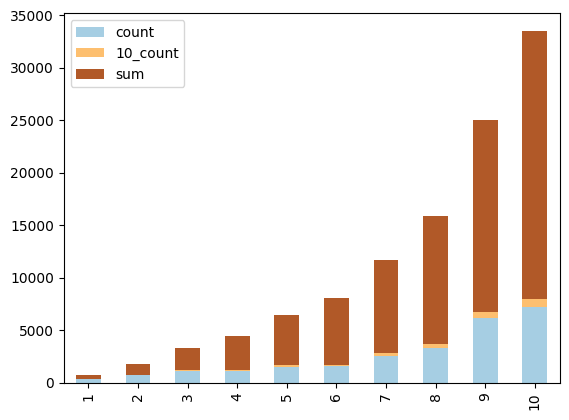

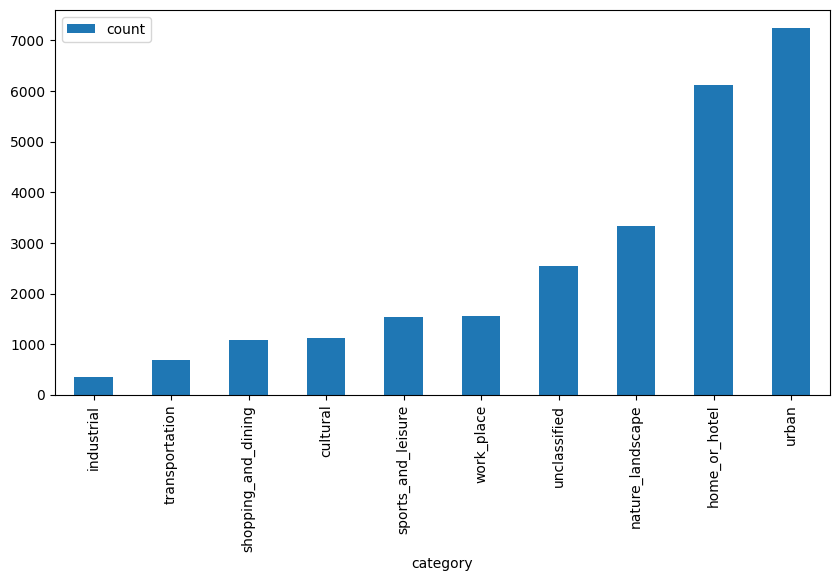

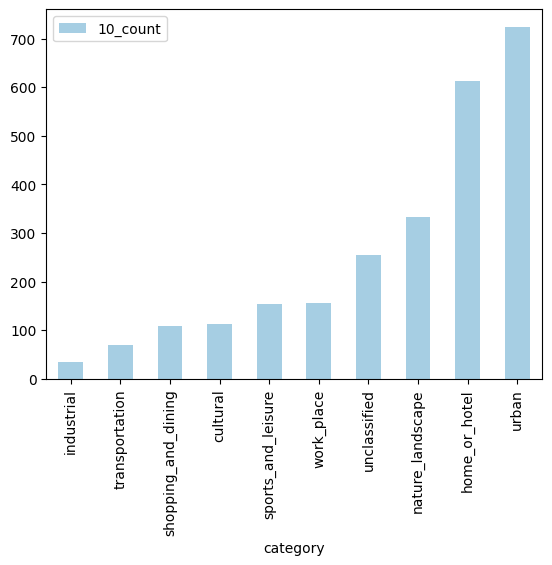

In [51]:
#Mapping Data and countplot
grouped_Data.plot.bar(colormap='Paired',stacked=True)
grouped_Data.plot.bar(x='category',y='count',figsize = (10, 5),width=0.5, align='center')
grouped_Data.plot.bar(x='category',y='10_count', align='center',stacked=True,colormap='Paired')
plt.show()

## Selecting Categories 

In [62]:
all = list(df["subCategory"].unique())

classroom, lab_classroom, lecture_room,beach,dam,ditch,cafeteria,playground,bus_shelter,crosswalk, downtown, farm, hospital, police_station,railroad_track,street,town_house

In [176]:
selected_subcat = ["classroom", "lab_classroom", "lecture_room","conference_room","computer_room",
                   "beach","dam","playground","bus_shelter","crosswalk","skyscraper","highway"
                   "downtown", "farm", "hospital", "police_station",
                   "railroad_track","street","town_house","excavation","industrial_area",
                   "mountain","corridor","landfill","cliff","hill","skyscraper","coast","park","bridge","house"]

In [177]:
selected_subcat.sort()

In [178]:
selected_subcat

['beach',
 'bridge',
 'bus_shelter',
 'classroom',
 'cliff',
 'coast',
 'computer_room',
 'conference_room',
 'corridor',
 'crosswalk',
 'dam',
 'excavation',
 'farm',
 'highwaydowntown',
 'hill',
 'hospital',
 'house',
 'industrial_area',
 'lab_classroom',
 'landfill',
 'lecture_room',
 'mountain',
 'park',
 'playground',
 'police_station',
 'railroad_track',
 'skyscraper',
 'skyscraper',
 'street',
 'town_house']

In [179]:
len(selected_subcat)

30

In [180]:
selected_subcat_25  = df.loc[df['subCategory'].isin(selected_subcat)]

In [181]:
selected_subcat_25.groupby(['subCategory'])['subCategory'].count().sort_values()

subCategory
police_station        1
lab_classroom         8
bus_shelter           9
town_house           11
landfill             14
railroad_track       18
dam                  19
hospital             19
lecture_room         21
computer_room        22
excavation           22
crosswalk            24
farm                 25
industrial_area      26
cliff                30
hill                 35
playground           40
classroom            60
bridge               65
house                73
park                106
coast               131
beach               138
corridor            143
mountain            168
conference_room     211
skyscraper          415
street             2060
Name: subCategory, dtype: int64

In [107]:
train_dir = u"D:\Grad Project\Code\Scene-Parsing\dataset\Train/"
val_dir = u"D:\Grad Project\Code\Scene-Parsing\dataset\Val/"
train_dataset_path = u""
classes = selected_subcat
label2idx = {label : idx for idx, label in enumerate(classes)}
idx2label = {val : key for key, val in label2idx.items()}


In [169]:
# Copy the image files to destination folder
def copy_files(copy_path):
    for i in range(int(selected_subcat_25.shape[0])):
        img_path = rec = selected_subcat_25["SubFolder"].iloc[i] + selected_subcat_25["Image"].iloc[i]
        seg_img_path = rec = selected_subcat_25["SubFolder"].iloc[i] + selected_subcat_25["seg"].iloc[i]
        class_label = selected_subcat_25["subCategory"].iloc[i]
        dest_path = copy_path+class_label+'/'
        if os.path.isdir(dest_path):
            shutil.copy(img_path, dest_path)


In [154]:
classes

['beach',
 'bridge',
 'bus_shelter',
 'classroom',
 'cliff',
 'coast',
 'computer_room',
 'conference_room',
 'corridor',
 'crosswalk',
 'dam',
 'excavation',
 'farm',
 'highwaydowntown',
 'hill',
 'hospital',
 'house',
 'industrial_area',
 'lab_classroom',
 'landfill',
 'lecture_room',
 'mountain',
 'park',
 'playground',
 'police_station',
 'railroad_track',
 'skyscraper',
 'skyscraper',
 'street',
 'town_house']

In [170]:
#To craete Training and Validation dataset
copy_path = "D:\Grad Project\Code\Scene-Parsing\dataset\Train/"
def create_train_dir(train_dir):
    #os.mkdir('/kaggle/working/dataset/train')
    for label in classes:
        if not os.path.exists(os.path.join(train_dir+label)):
            os.mkdir(train_dir+label)
    copy_files(copy_path)
                

copy_path_val = "D:\Grad Project\Code\Scene-Parsing\dataset\Val/"
def create_val_dir(val_dir):
    #os.mkdir('./dataset/validation')
    for label in classes:
        if not os.path.exists(os.path.join(val_dir+label)):
            os.mkdir(val_dir+label)
    copy_files(copy_path_val)


In [171]:
#Craete Training Dataset
create_train_dir(train_dir)

In [172]:
##Craete Validation Dataset
create_val_dir(val_dir)